# Department of Transportation - Oil Spill Mapping

In [23]:
# Dependencies and Setup
import pandas as pd
import requests
import gmaps
import openpyxl
import folium
import json
import gmaps.datasets
import numpy as np
import re
# from shapely.geometry import Point, Polygon
# import geopandas as gpd
# import descartes
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import geopandas
import seaborn as sns
%matplotlib inline
%matplotlib notebook

# Import API key
# from config import g_map

# Configure gmaps
# gmaps.configure(api_key=g_map)

## Bring in 2010 - Present Data

In [9]:
# 1. Read the Data_Columns_and_spills into a DataFrame. All sheets
# Unedited excel files
xlfile_2010 = pd.ExcelFile("Resources/Data_columns_and_spills.xlsx", engine='openpyxl')
spill2010_df = xlfile_2010.parse('2010-Present') #'2010-Present' is the sheet name in the excel file
#spill2010_df is all data all columns




In [10]:
spill2010_df

,REPORT_RECEIVED_DATE,IYEAR,REPORT_NUMBER,SUPPLEMENTAL_NUMBER,REPORT_TYPE,OPERATOR_ID,NAME,OPERATOR_STREET_ADDRESS,OPERATOR_CITY_NAME,OPERATOR_STATE_ABBREVIATION,...,PREPARER_TITLE,PREPARER_EMAIL,PREPARER_TELEPHONE,PREPARER_FAX,PREPARED_DATE,AUTHORIZER_NAME,AUTHORIZER_TITLE,AUTHORIZER_TELEPHONE,AUTHORIZER_EMAIL,NARRATIVE
0,2018-12-10,2018,20180382,32252,SUPPLEMENTAL FINAL,31130,DCP MIDSTREAM,370 17TH STREET SUITE 2500,DENVER,CO,...,SR. PIPELINE COMPLIANCE SPECIALIST,kdneden@dcpmidstream.com,979-242-6976,NaN,2019-06-07,JOHN PONTIOUS,MANAGER PIPELINE COMPLIANCE,405-605-3859,jdpontious@dcpmidstream.com,DCP CONTRACT LINE LOCATOR GUADALUPE VALDES PRO...
1,2020-11-06,2020,20200300,34501,ORIGINAL FINAL,32545,"DENBURY GULF COAST PIPELINES, LLC",5851 LEGACY CIRCLE SUITE 1200,PLANO,TX,...,REGULATORY COMPLIANCE SPECIALIST,chad.docekal@denbury.com,972-673-2734,NaN,2020-11-06,DAVID SHEPPARD,SENIOR VICE PRESIDENT - OPERATIONS,972-673-2038,david.sheppard@denbury.com,"ON 10/7/2020 AT 17:31, DENBURY BEGAN BLOWDOWN ..."
2,2015-02-24,2015,20150071,21327,SUPPLEMENTAL FINAL,31618,ENTERPRISE PRODUCTS OPERATING LLC,1100 LOUISIANA STREET,HOUSTON,TX,...,SR. COMPLIANCE SPECIALIST,mjpavlak@eprod.com,713-381-5897,NaN,2016-04-21,MICHAEL PAVLAK,SR. COMPLIANCE SPECIALIST,713-381-5897,mjpavlak@eprod.com,AT APPROXIMATELY 9:40 A.M. C.S.T. ON JANUARY 2...
3,2020-09-13,2020,20200253,35187,SUPPLEMENTAL,2552,COLONIAL PIPELINE CO,1185 SANCTUARY PARKWAY SUITE 100,ALPHARETTA,GA,...,MANAGER - PIPELINE COMPLIANCE,mpiazza@colpipe.com,678-763-5911,NaN,2021-04-17,MARK PIAZZA,MANAGER - PIPELINE COMPLIANCE,678-763-5911,mpiazza@colpipe.com,"ON 8/14/2020 AT 18:20, A COLONIAL EMPLOYEE WAS..."
4,2015-02-06,2015,20150040,20630,SUPPLEMENTAL FINAL,31618,ENTERPRISE PRODUCTS OPERATING LLC,1100 LOUISIANA STREET,HOUSTON,TX,...,SR. PIPELINE COMPLIANCE SPECIALIST,wnburrell@eprod.com,713-381-3536,NaN,2015-07-29,NEAL BURRELL,SR. PIPELINE COMPLIANCE SPECIALIST,713-381-3536,wnburrell@eprod.com,"ON 1/10/2015 AT 20:45 HRS, PIPELINE CONTROL DI..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4635,2018-01-08,2017,20180006,23089,SUPPLEMENTAL FINAL,3445,DIXIE PIPELINE COMPANY LLC,1100 LOUISIANA ST.,HOUSTON,TX,...,PIPELINE COMPLIANCE ENGINEER,lswilliams@eprod.com,713-381-6748,NaN,2018-02-01,SUZIE DAVIS,COMPLIANCE MANAGER,713-381-5585,smdavis@eprod.com,PUMP SHUT DOWN DUE TO HIGH BEARING TEMPERATURE...
4636,2018-05-30,2018,20180156,30565,SUPPLEMENTAL FINAL,30829,ENTERPRISE CRUDE PIPELINE LLC,1100 LOUISIANA STREET,HOUSTON,TX,...,PIPELINE COMPLIANCE SENIOR ENGINEER,lswilliams@eprod.com,713-381-6748,NaN,2018-06-28,LEANN WILLIAMS,PIPELINE COMPLIANCE SENIOR ENGINEER,713-381-6748,lswilliams@eprod.com,"DURING TANK REPAIRS, CONTRACT EMPLOYEE REMOVED..."
4637,2019-01-03,2018,20190001,31424,ORIGINAL FINAL,39145,ENBRIDGE STORAGE (CUSHING) L.L.C.,5400 WESTHEIMER COURT,HOUSTON,TX,...,SR COMPLIANCE ANALYST,stacy.soine@enbridge.com,715-395-3620,NaN,2019-01-03,RON CARLBERG,SUPERVISOR US PIPELINE COMPLIANCE,715-395-3619,ron.carlberg@enbridge.com,"ON DECEMBER 4, 2018 AT APPROXIMATELY 20:10 CST..."
4638,2019-01-24,2018,20190021,33804,SUPPLEMENTAL FINAL,300,"PLAINS PIPELINE, L.P.","333 CLAY STREET, SUITE 1900",HOUSTON,TX,...,ERC COMPLIANCE SPECIALIST,nagonzalez@paalp.com,713-646-4376,NaN,2020-05-27,NGIABI GICUHI,ERC MGR DIRECTOR,713-646-4336,ngicuhi@paalp.com,"ON 08/28/2018 AT ~7:40 A.M., THE PRIMARY AND S..."


In [11]:
spills = spill2010_df.to_dict('records')
spills

[{'REPORT_RECEIVED_DATE': Timestamp('2018-12-10 00:00:00'),
  'IYEAR': 2018,
  'REPORT_NUMBER': 20180382,
  'SUPPLEMENTAL_NUMBER': 32252,
  'REPORT_TYPE': 'SUPPLEMENTAL FINAL',
  'OPERATOR_ID': 31130,
  'NAME': 'DCP MIDSTREAM',
  'OPERATOR_STREET_ADDRESS': '370 17TH STREET SUITE 2500',
  'OPERATOR_CITY_NAME': 'DENVER',
  'OPERATOR_STATE_ABBREVIATION': 'CO',
  'OPERATOR_POSTAL_CODE': 80202,
  'LOCAL_DATETIME': Timestamp('2018-11-10 14:18:00'),
  'LOCATION_LATITUDE': 30.3515556,
  'LOCATION_LONGITUDE': -100.5817917,
  'NRC_RPT_NUM': 1230061,
  'NRC_RPT_DATETIME': Timestamp('2018-11-10 17:50:00'),
  'COMMODITY_RELEASED_TYPE': 'HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS A GAS AT AMBIENT CONDITIONS',
  'COMMODITY_SUBTYPE': 'LPG (LIQUEFIED PETROLEUM GAS)  /  NGL (NATURAL GAS LIQUID)',
  'COMMODITY_DETAILS': nan,
  'BLEND_DETAILS': nan,
  'BIO_DIESEL_DETAILS': nan,
  'UNINTENTIONAL_RELEASE_BBLS': 48400.0,
  'INTENTIONAL_RELEASE_BBLS': 0.0,
  'RECOVERED_BBLS': 0.0,
  'FATALITY_IND': 'NO',


In [ ]:
# import pandas as pd
# from shapely.geometry import Point
# import geopandas as gpd
# from geopandas import GeoDataFrame

# geometry = [Point(xy) for xy in zip(latlong_df['LOCATION_LATITUDE'], latlong_df['LOCATION_LONGITUDE'])]
# gdf = GeoDataFrame(latlong_df, geometry=geometry)   

# #this is a simple map that goes with geopandas
# world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
# gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15);

In [12]:
# formatting dataframe for mapping display. 
# Have to change datetime to string for json conversion
spill2010_df["REPORT_RECEIVED_DATE"] = spill2010_df["REPORT_RECEIVED_DATE"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["LOCAL_DATETIME"] = spill2010_df["LOCAL_DATETIME"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["NRC_RPT_DATETIME"] = spill2010_df["NRC_RPT_DATETIME"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["SHUTDOWN_DATETIME"] = spill2010_df["SHUTDOWN_DATETIME"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["RESTART_DATETIME"] = spill2010_df["RESTART_DATETIME"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["INCIDENT_IDENTIFIED_DATETIME"] = spill2010_df["INCIDENT_IDENTIFIED_DATETIME"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["ON_SITE_DATETIME"] = spill2010_df["ON_SITE_DATETIME"].dt.strftime('%Y-%m-%d %H:%M:%S')
spill2010_df["PREPARED_DATE"] = spill2010_df["PREPARED_DATE"].dt.strftime('%Y-%m-%d %H:%M:%S')
# Creating additional columns of UNINTENTIONAL_RELEASE_BBLS and PRPTY as a string for popup but still need 
# UNINTENTIONAL_RELEASE_BBLS and PRPTY as float for plotting
spill2010_df["UNINTENTIONAL_RELEASE_BBLS_STR"] = spill2010_df["UNINTENTIONAL_RELEASE_BBLS"].map("{:,.2f}".format)
spill2010_df["PRPTY_STR"] = spill2010_df["PRPTY"].map("${:,.0f}".format)


In [13]:
spill2010_df["COMPONENT_AGE(YEARS)"] = (spill2010_df["IYEAR"] - spill2010_df["INSTALLATION_YEAR"]) + 1
spill2010_df.head()

,REPORT_RECEIVED_DATE,IYEAR,REPORT_NUMBER,SUPPLEMENTAL_NUMBER,REPORT_TYPE,OPERATOR_ID,NAME,OPERATOR_STREET_ADDRESS,OPERATOR_CITY_NAME,OPERATOR_STATE_ABBREVIATION,...,PREPARER_FAX,PREPARED_DATE,AUTHORIZER_NAME,AUTHORIZER_TITLE,AUTHORIZER_TELEPHONE,AUTHORIZER_EMAIL,NARRATIVE,UNINTENTIONAL_RELEASE_BBLS_STR,PRPTY_STR,COMPONENT_AGE(YEARS)
0,2018-12-10 00:00:00,2018,20180382,32252,SUPPLEMENTAL FINAL,31130,DCP MIDSTREAM,370 17TH STREET SUITE 2500,DENVER,CO,...,NaN,2019-06-07 00:00:00,JOHN PONTIOUS,MANAGER PIPELINE COMPLIANCE,405-605-3859,jdpontious@dcpmidstream.com,DCP CONTRACT LINE LOCATOR GUADALUPE VALDES PRO...,"48,400.00","$15,200,000",6.0
1,2020-11-06 00:00:00,2020,20200300,34501,ORIGINAL FINAL,32545,"DENBURY GULF COAST PIPELINES, LLC",5851 LEGACY CIRCLE SUITE 1200,PLANO,TX,...,NaN,2020-11-06 00:00:00,DAVID SHEPPARD,SENIOR VICE PRESIDENT - OPERATIONS,972-673-2038,david.sheppard@denbury.com,"ON 10/7/2020 AT 17:31, DENBURY BEGAN BLOWDOWN ...","41,177.00","$64,998",12.0
2,2015-02-24 00:00:00,2015,20150071,21327,SUPPLEMENTAL FINAL,31618,ENTERPRISE PRODUCTS OPERATING LLC,1100 LOUISIANA STREET,HOUSTON,TX,...,NaN,2016-04-21 00:00:00,MICHAEL PAVLAK,SR. COMPLIANCE SPECIALIST,713-381-5897,mjpavlak@eprod.com,AT APPROXIMATELY 9:40 A.M. C.S.T. ON JANUARY 2...,"30,565.00","$6,910,591",3.0
3,2020-09-13 00:00:00,2020,20200253,35187,SUPPLEMENTAL,2552,COLONIAL PIPELINE CO,1185 SANCTUARY PARKWAY SUITE 100,ALPHARETTA,GA,...,NaN,2021-04-17 00:00:00,MARK PIAZZA,MANAGER - PIPELINE COMPLIANCE,678-763-5911,mpiazza@colpipe.com,"ON 8/14/2020 AT 18:20, A COLONIAL EMPLOYEE WAS...","28,571.00","$64,253,139",43.0
4,2015-02-06 00:00:00,2015,20150040,20630,SUPPLEMENTAL FINAL,31618,ENTERPRISE PRODUCTS OPERATING LLC,1100 LOUISIANA STREET,HOUSTON,TX,...,NaN,2015-07-29 00:00:00,NEAL BURRELL,SR. PIPELINE COMPLIANCE SPECIALIST,713-381-3536,wnburrell@eprod.com,"ON 1/10/2015 AT 20:45 HRS, PIPELINE CONTROL DI...","27,123.00","$782,260",50.0


## Mapping 2010-Present Spills

In [14]:
# Pulling useful columns for mapping purposes
my_columns = [
    'REPORT_NUMBER',
    'NAME',
    'LOCATION_LATITUDE',
    'LOCATION_LONGITUDE',
    'COMMODITY_RELEASED_TYPE',
    'UNINTENTIONAL_RELEASE_BBLS',
    'UNINTENTIONAL_RELEASE_BBLS_STR',
    'ON_OFF_SHORE',
    'ONSHORE_CITY_NAME',
    'ONSHORE_COUNTY_NAME',
    'ONSHORE_STATE_ABBREVIATION',
    'SYSTEM_PART_INVOLVED',
    'INSTALLATION_YEAR',
    'COMPONENT_AGE(YEARS)',
    'CAUSE',
    'ACCIDENT_PSIG',
    'MOP_PSIG',
    'PRPTY',
    'PRPTY_STR'
]

In [15]:
# mapping columns called info2010_df
mapping_df = spill2010_df[my_columns]
# Creating another dataframe of first 100 rows called 'test' t2010_df
# Used to get map functioning and limiting API requests
# t2010_df = info2010_df[:100]
# t2010_df.to_json('test_df.json') # exports DataFrame to json for javascript and mapping functionality
# t2010_df
mapping_df

,REPORT_NUMBER,NAME,LOCATION_LATITUDE,LOCATION_LONGITUDE,COMMODITY_RELEASED_TYPE,UNINTENTIONAL_RELEASE_BBLS,UNINTENTIONAL_RELEASE_BBLS_STR,ON_OFF_SHORE,ONSHORE_CITY_NAME,ONSHORE_COUNTY_NAME,ONSHORE_STATE_ABBREVIATION,SYSTEM_PART_INVOLVED,INSTALLATION_YEAR,COMPONENT_AGE(YEARS),CAUSE,ACCIDENT_PSIG,MOP_PSIG,PRPTY,PRPTY_STR
0,20180382,DCP MIDSTREAM,30.351556,-100.581792,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,48400.0,"48,400.00",ONSHORE,Not Within a Municipality,SUTTON,TX,"ONSHORE PIPELINE, INCLUDING VALVE SITES",2013.0,6.0,EXCAVATION DAMAGE,1044.0,1440.0,15200000.0,"$15,200,000"
1,20200300,"DENBURY GULF COAST PIPELINES, LLC",32.628233,-90.569264,CO2 (CARBON DIOXIDE),41177.0,"41,177.00",ONSHORE,Not Within a Municipality,YAZOO COUNTY,MS,"ONSHORE PIPELINE, INCLUDING VALVE SITES",2009.0,12.0,EQUIPMENT FAILURE,980.0,2160.0,64998.0,"$64,998"
2,20150071,ENTERPRISE PRODUCTS OPERATING LLC,40.366817,-80.584594,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,30565.0,"30,565.00",ONSHORE,COLLIERS,BROOKE,WV,"ONSHORE PIPELINE, INCLUDING VALVE SITES",2013.0,3.0,MATERIAL FAILURE OF PIPE OR WELD,1183.0,1440.0,6910591.0,"$6,910,591"
3,20200253,COLONIAL PIPELINE CO,35.414106,-80.806185,REFINED AND/OR PETROLEUM PRODUCT (NON-HVL) WHI...,28571.0,"28,571.00",ONSHORE,HUNTERSVILLE,MECKLENBURG,NC,"ONSHORE PIPELINE, INCLUDING VALVE SITES",1978.0,43.0,MATERIAL FAILURE OF PIPE OR WELD,183.0,673.0,64253139.0,"$64,253,139"
4,20150040,ENTERPRISE PRODUCTS OPERATING LLC,28.885881,-96.433027,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,27123.0,"27,123.00",ONSHORE,Not Within a Municipality,JACKSON,TX,"ONSHORE PIPELINE, INCLUDING VALVE SITES",1966.0,50.0,MATERIAL FAILURE OF PIPE OR WELD,922.0,1024.0,782260.0,"$782,260"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4635,20180006,DIXIE PIPELINE COMPANY LLC,33.362982,-83.447904,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,0.0,0.00,ONSHORE,EATONTON,PUTNAM,GA,ONSHORE PUMP/METER STATION EQUIPMENT AND PIPING,NaN,NaN,EQUIPMENT FAILURE,1323.0,1440.0,8588.0,"$8,588"
4636,20180156,ENTERPRISE CRUDE PIPELINE LLC,29.741758,-95.124244,CRUDE OIL,0.0,0.00,ONSHORE,HOUSTON,HARRIS,TX,"ONSHORE BREAKOUT TANK OR STORAGE VESSEL, INCLU...",NaN,NaN,INCORRECT OPERATION,0.0,0.0,0.0,$0
4637,20190001,ENBRIDGE STORAGE (CUSHING) L.L.C.,35.940630,-96.748440,CRUDE OIL,0.0,0.00,ONSHORE,CUSHING,LINCOLN,OK,ONSHORE TERMINAL/TANK FARM EQUIPMENT AND PIPING,2018.0,1.0,EQUIPMENT FAILURE,0.0,275.0,8368.0,"$8,368"
4638,20190021,"PLAINS PIPELINE, L.P.",33.916010,-98.436540,CRUDE OIL,0.0,0.00,ONSHORE,WICHITA FALLS,WICHITA,TX,"ONSHORE BREAKOUT TANK OR STORAGE VESSEL, INCLU...",1949.0,70.0,INCORRECT OPERATION,0.0,0.0,2030538.0,"$2,030,538"


In [16]:
# # Join lat and long into one column...might be easier for mapping json
# t2010_df.isnull().sum(axis = 0)

In [17]:
mapping_df = mapping_df.fillna('N/A')
mapping_df

,REPORT_NUMBER,NAME,LOCATION_LATITUDE,LOCATION_LONGITUDE,COMMODITY_RELEASED_TYPE,UNINTENTIONAL_RELEASE_BBLS,UNINTENTIONAL_RELEASE_BBLS_STR,ON_OFF_SHORE,ONSHORE_CITY_NAME,ONSHORE_COUNTY_NAME,ONSHORE_STATE_ABBREVIATION,SYSTEM_PART_INVOLVED,INSTALLATION_YEAR,COMPONENT_AGE(YEARS),CAUSE,ACCIDENT_PSIG,MOP_PSIG,PRPTY,PRPTY_STR
0,20180382,DCP MIDSTREAM,30.351556,-100.581792,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,48400.0,"48,400.00",ONSHORE,Not Within a Municipality,SUTTON,TX,"ONSHORE PIPELINE, INCLUDING VALVE SITES",2013.0,6.0,EXCAVATION DAMAGE,1044.0,1440.0,15200000.0,"$15,200,000"
1,20200300,"DENBURY GULF COAST PIPELINES, LLC",32.628233,-90.569264,CO2 (CARBON DIOXIDE),41177.0,"41,177.00",ONSHORE,Not Within a Municipality,YAZOO COUNTY,MS,"ONSHORE PIPELINE, INCLUDING VALVE SITES",2009.0,12.0,EQUIPMENT FAILURE,980.0,2160.0,64998.0,"$64,998"
2,20150071,ENTERPRISE PRODUCTS OPERATING LLC,40.366817,-80.584594,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,30565.0,"30,565.00",ONSHORE,COLLIERS,BROOKE,WV,"ONSHORE PIPELINE, INCLUDING VALVE SITES",2013.0,3.0,MATERIAL FAILURE OF PIPE OR WELD,1183.0,1440.0,6910591.0,"$6,910,591"
3,20200253,COLONIAL PIPELINE CO,35.414106,-80.806185,REFINED AND/OR PETROLEUM PRODUCT (NON-HVL) WHI...,28571.0,"28,571.00",ONSHORE,HUNTERSVILLE,MECKLENBURG,NC,"ONSHORE PIPELINE, INCLUDING VALVE SITES",1978.0,43.0,MATERIAL FAILURE OF PIPE OR WELD,183.0,673.0,64253139.0,"$64,253,139"
4,20150040,ENTERPRISE PRODUCTS OPERATING LLC,28.885881,-96.433027,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,27123.0,"27,123.00",ONSHORE,Not Within a Municipality,JACKSON,TX,"ONSHORE PIPELINE, INCLUDING VALVE SITES",1966.0,50.0,MATERIAL FAILURE OF PIPE OR WELD,922.0,1024.0,782260.0,"$782,260"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4635,20180006,DIXIE PIPELINE COMPANY LLC,33.362982,-83.447904,HVL OR OTHER FLAMMABLE OR TOXIC FLUID WHICH IS...,0.0,0.00,ONSHORE,EATONTON,PUTNAM,GA,ONSHORE PUMP/METER STATION EQUIPMENT AND PIPING,N/A,N/A,EQUIPMENT FAILURE,1323.0,1440.0,8588.0,"$8,588"
4636,20180156,ENTERPRISE CRUDE PIPELINE LLC,29.741758,-95.124244,CRUDE OIL,0.0,0.00,ONSHORE,HOUSTON,HARRIS,TX,"ONSHORE BREAKOUT TANK OR STORAGE VESSEL, INCLU...",N/A,N/A,INCORRECT OPERATION,0.0,0.0,0.0,$0
4637,20190001,ENBRIDGE STORAGE (CUSHING) L.L.C.,35.940630,-96.748440,CRUDE OIL,0.0,0.00,ONSHORE,CUSHING,LINCOLN,OK,ONSHORE TERMINAL/TANK FARM EQUIPMENT AND PIPING,2018.0,1.0,EQUIPMENT FAILURE,0.0,275.0,8368.0,"$8,368"
4638,20190021,"PLAINS PIPELINE, L.P.",33.916010,-98.436540,CRUDE OIL,0.0,0.00,ONSHORE,WICHITA FALLS,WICHITA,TX,"ONSHORE BREAKOUT TANK OR STORAGE VESSEL, INCLU...",1949.0,70.0,INCORRECT OPERATION,0.0,0.0,2030538.0,"$2,030,538"


In [31]:
operator = mapping_df['NAME'].value_counts().head(20)
operator_df = pd.DataFrame(operator)
operator_df

,NAME
ENTERPRISE CRUDE PIPELINE LLC,330
ENTERPRISE PRODUCTS OPERATING LLC,266
SUNOCO PIPELINE L.P.,248
"PLAINS PIPELINE, L.P.",240
"MAGELLAN PIPELINE COMPANY, LP",215
COLONIAL PIPELINE CO,200
"BUCKEYE PARTNERS, LP",171
"KINDER MORGAN LIQUID TERMINALS, LLC",150
PHILLIPS 66 PIPELINE LLC,147
MARATHON PIPE LINE LLC,127


<IPython.core.display.Javascript object>


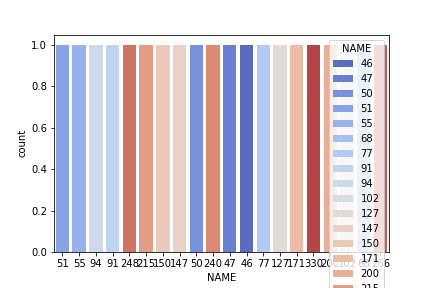

<module 'matplotlib.pyplot' from 'C:\\Users\\Local User\\anaconda3\\envs\\PythonData\\lib\\site-packages\\matplotlib\\pyplot.py'>

In [33]:
sns.countplot(x='NAME',data=operator_df,hue='NAME',palette='coolwarm',
             dodge=False,order = operator_df['NAME'].value_counts().index)
plt

In [18]:
# dataframe to dictionary
mapping_dict = mapping_df.to_dict('records')


In [ ]:
# making dict into easy to read json for JS array
json_mapping = json.dumps(mapping_dict, indent = 4)
print(json_mapping)

In [ ]:
mapping_dict = mapping_df.to_dict('records')
json_mapping = json.dumps(mapping_dict, indent = 4)
with open('mapping.json','w') as data:
    data.write(json_mapping)

## Mapping 2010-Present 'info2010_df' spill locations ~4000 locations

In [ ]:
info_box_template = """
<dl>
<dt>Operator ID: </dt><dd>{OPERATOR_ID}</dd>
<dt>City</dt><dd>{ONSHORE_CITY_NAME}</dd>
<dt>State</dt><dd>{ONSHORE_STATE_ABBREVIATION}</dd>
<dt>Spill Commodity</dt><dd>{COMMODITY_RELEASED_TYPE}</dd>
<dt>Spill Volume (bbls)</dt><dd>{UNINTENTIONAL_RELEASE_BBLS}</dd>
</dl>

"""


spill_info = [info_box_template.format(**row) for index, row in info2010_df.iterrows()]

In [ ]:
# Create map from lat and long
locations = info2010_df[["LOCATION_LATITUDE","LOCATION_LONGITUDE"]]
spill = info2010_df["UNINTENTIONAL_RELEASE_BBLS"]
fig = gmaps.figure(center=(36, -97), zoom_level=4)
heat_layer = gmaps.heatmap_layer(locations, weights=spill,dissipating=False,
            max_intensity=30000, point_radius=2)
marker_layer = gmaps.marker_layer(locations, info_box_content=spill_info)
fig.add_layer(heat_layer)
fig.add_layer(marker_layer)
#Display the figure
fig

## Add another map 
### Filtering only pipeline, corrosion failures
### showing property damage instead of spill volume

In [ ]:
my_columns = [
    'REPORT_NUMBER',
    'OPERATOR_ID',
    'LOCATION_LATITUDE',
    'LOCATION_LONGITUDE',
    'COMMODITY_RELEASED_TYPE',
    'UNINTENTIONAL_RELEASE_BBLS',
    'ON_OFF_SHORE',
    'ONSHORE_CITY_NAME',
    'ONSHORE_COUNTY_NAME',
    'ONSHORE_STATE_ABBREVIATION',
    'SYSTEM_PART_INVOLVED',
    'INSTALLATION_YEAR',
    'CAUSE',
    'PRPTY'
    ]

In [ ]:
pipeline_df = spill2010_df[my_columns]
pipeline_df

In [ ]:
# # changing formatting of Property column to currency
# pipeline_df['PRPTY'] = pipeline_df['PRPTY'].apply(lambda x: "${:,.0f}".format(x))
# pipeline_df

In [ ]:
# Filtering causes; showing only corrosion failure, material failure of pipe or weld and equipment failure.
pipeline_df.loc[(pipeline_df["CAUSE"] == "CORROSION FAILURE") & 
                       (pipeline_df["CAUSE"] == "MATERIAL FAILURE OF PIPE OR WELD") &
                       (pipeline_df["CAUSE"] == "EQUIPMENT FAILURE")]
pipeline_df

In [ ]:
info_box_template = """
<dl>
<dt>Operator ID: </dt><dd>{OPERATOR_ID}</dd>
<dt>City</dt><dd>{ONSHORE_CITY_NAME}</dd>
<dt>State</dt><dd>{ONSHORE_STATE_ABBREVIATION}</dd>
<dt>Cause:</dt><dd>{CAUSE}</dd>
<dt>Spill Commodity</dt><dd>{COMMODITY_RELEASED_TYPE}</dd>
<dt>Spill Volume (bbls)</dt><dd>{UNINTENTIONAL_RELEASE_BBLS}</dd>
<dt>Spill Cost</dt><dd>{PRPTY}</dd>
</dl>

"""

# Using the pipeline_df to gather spill info for marker data...
spill_info = [info_box_template.format(**row) for index, row in pipeline_df.iterrows()]

In [ ]:
# Create map from lat and long
locations = pipeline_df[["LOCATION_LATITUDE","LOCATION_LONGITUDE"]]
spill = pipeline_df["PRPTY"]
fig = gmaps.figure(center=(36, -97), zoom_level=4)
heat_layer = gmaps.heatmap_layer(locations, weights=spill,dissipating=False,
            max_intensity=1000000000, point_radius=2)
marker_layer = gmaps.marker_layer(locations, info_box_content=spill_info)
fig.add_layer(heat_layer)
fig.add_layer(marker_layer)
#Display the figure
fig